In [37]:
import numpy as np
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

#!pip install wordcloud
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords
#!pip install scikit-plot
from warnings import filterwarnings
filterwarnings('ignore')

In [38]:
ha=pd.read_csv('heart_disease_health_indicators_BRFSS2015.csv')


In [39]:
ha.columns

Index(['HeartDiseaseorAttack', 'HighBP', 'HighChol', 'CholCheck', 'BMI',
       'Smoker', 'Stroke', 'Diabetes', 'PhysActivity', 'Fruits', 'Veggies',
       'HvyAlcoholConsump', 'AnyHealthcare', 'NoDocbcCost', 'GenHlth',
       'MentHlth', 'PhysHlth', 'DiffWalk', 'Sex', 'Age', 'Education',
       'Income'],
      dtype='object')

In [40]:
ha.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 253680 entries, 0 to 253679
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   HeartDiseaseorAttack  253680 non-null  float64
 1   HighBP                253680 non-null  float64
 2   HighChol              253680 non-null  float64
 3   CholCheck             253680 non-null  float64
 4   BMI                   253680 non-null  float64
 5   Smoker                253680 non-null  float64
 6   Stroke                253680 non-null  float64
 7   Diabetes              253680 non-null  float64
 8   PhysActivity          253680 non-null  float64
 9   Fruits                253680 non-null  float64
 10  Veggies               253680 non-null  float64
 11  HvyAlcoholConsump     253680 non-null  float64
 12  AnyHealthcare         253680 non-null  float64
 13  NoDocbcCost           253680 non-null  float64
 14  GenHlth               253680 non-null  float64
 15  

In [41]:
ha.describe()

,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,Fruits,...,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income
count,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,...,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000,253680.000000
mean,0.094186,0.429001,0.424121,0.962670,28.382364,0.443169,0.040571,0.296921,0.756544,0.634256,...,0.951053,0.084177,2.511392,3.184772,4.242081,0.168224,0.440342,8.032119,5.050434,6.053875
std,0.292087,0.494934,0.494210,0.189571,6.608694,0.496761,0.197294,0.698160,0.429169,0.481639,...,0.215759,0.277654,1.068477,7.412847,8.717951,0.374066,0.496429,3.054220,0.985774,2.071148
min,0.000000,0.000000,0.000000,0.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
25%,0.000000,0.000000,0.000000,1.000000,24.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,6.000000,4.000000,5.000000
50%,0.000000,0.000000,0.000000,1.000000,27.000000,0.000000,0.000000,0.000000,1.000000,1.000000,...,1.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,8.000000,5.000000,7.000000
75%,0.000000,1.000000,1.000000,1.000000,31.000000,1.000000,0.000000,0.000000,1.000000,1.000000,...,1.000000,0.000000,3.000000,2.000000,3.000000,0.000000,1.000000,10.000000,6.000000,8.000000
max,1.000000,1.000000,1.000000,1.000000,98.000000,1.000000,1.000000,2.000000,1.000000,1.000000,...,1.000000,1.000000,5.000000,30.000000,30.000000,1.000000,1.000000,13.000000,6.000000,8.000000


In [42]:
ha.drop(['Fruits', 'Veggies','AnyHealthcare','NoDocbcCost','GenHlth','MentHlth','DiffWalk','Education','Income'], axis=1, inplace=True)

In [43]:
ha.head()

,HeartDiseaseorAttack,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,Diabetes,PhysActivity,HvyAlcoholConsump,PhysHlth,Sex,Age
0,0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,15.0,0.0,9.0
1,0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,7.0
2,0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,0.0,30.0,0.0,9.0
3,0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,11.0
4,0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,11.0


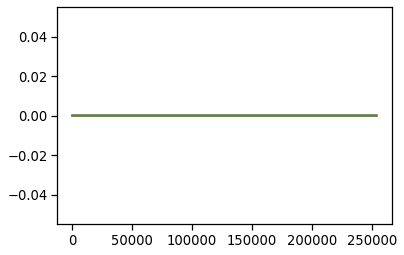

In [44]:
#checking missing data
plt.plot(ha.isnull())

In [45]:
#Logistic regression
x=ha[['HighBP','HighChol','CholCheck','BMI','Smoker','Stroke','Diabetes','PhysActivity','HvyAlcoholConsump','PhysHlth']]
y=ha['HeartDiseaseorAttack']

from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.4,random_state=101)

from sklearn.linear_model import LogisticRegression
ha_model=LogisticRegression()
ha_model.fit(x_train,y_train)
prediction=ha_model.predict(x_test)

#Evaluation of model 
from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_test,prediction))
print('\n')
print(confusion_matrix(y_test,prediction))

              precision    recall  f1-score   support

         0.0       0.91      0.99      0.95     91961
         1.0       0.53      0.07      0.12      9511

    accuracy                           0.91    101472
   macro avg       0.72      0.53      0.53    101472
weighted avg       0.88      0.91      0.87    101472



[[91399   562]
 [ 8889   622]]


In [46]:
#Correlation
corr=ha.corr()
corr['HeartDiseaseorAttack'].sort_values(ascending=False)

HeartDiseaseorAttack    1.000000
Age                     0.221618
HighBP                  0.209361
Stroke                  0.203002
PhysHlth                0.181698
HighChol                0.180765
Diabetes                0.180272
Smoker                  0.114441
Sex                     0.086096
BMI                     0.052904
CholCheck               0.044206
HvyAlcoholConsump      -0.028991
PhysActivity           -0.087299
Name: HeartDiseaseorAttack, dtype: float64

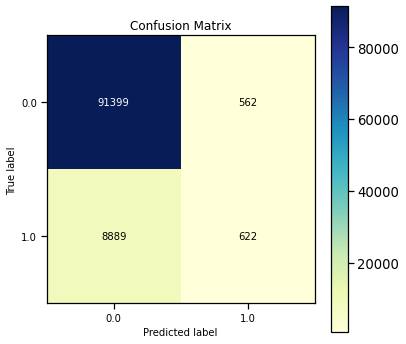

In [47]:
#!pip install scikit-plot

import scikitplot as skplt
skplt.metrics.plot_confusion_matrix(y_test,prediction, figsize=(6,6), cmap= 'YlGnBu');

<Figure size 792x504 with 0 Axes>

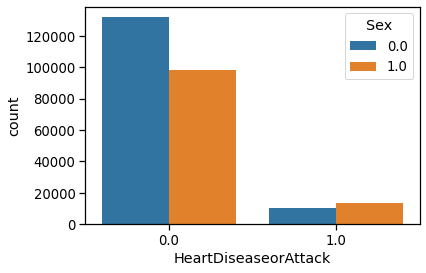

<Figure size 792x504 with 0 Axes>

In [48]:
sns.countplot(x='HeartDiseaseorAttack',hue='Sex',data=ha)
plt.figure(figsize=(11,7))

<AxesSubplot:xlabel='Age', ylabel='HeartDiseaseorAttack'>

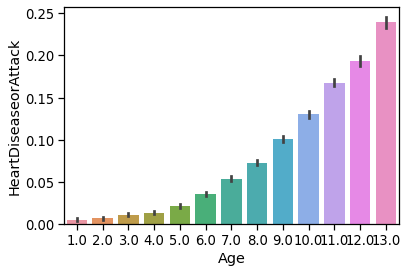

In [49]:
sns.barplot(x='Age',y='HeartDiseaseorAttack',data=ha)


<AxesSubplot:xlabel='HeartDiseaseorAttack', ylabel='count'>

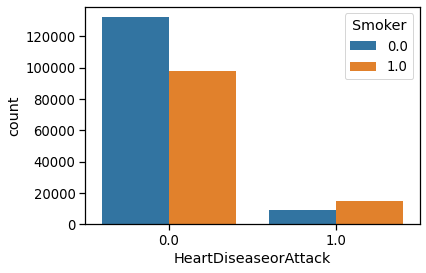

In [50]:
sns.countplot(x='HeartDiseaseorAttack',hue='Smoker',data=ha)

Heatmap


<AxesSubplot:>

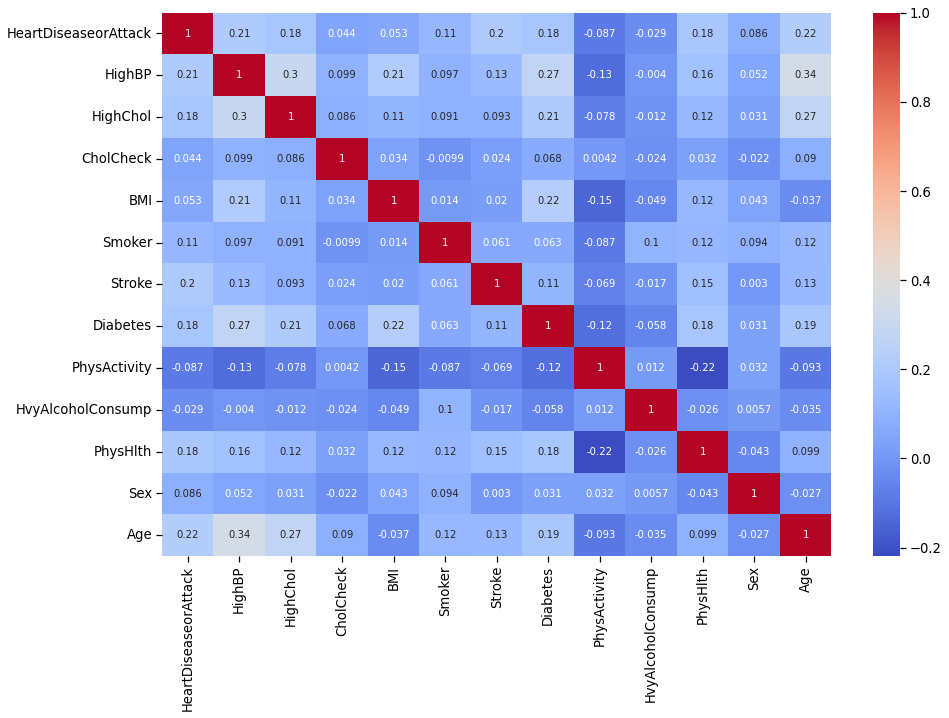

In [51]:
print('Heatmap')
plt.figure(figsize=(15,10))
sns.heatmap(ha.corr(),annot=True,cmap='coolwarm')

In [ ]:
import plotly.express as px
fig = px.histogram(ha, x="Age",color="HeartDiseaseorAttack",
                   marginal="box",
                   hover_data=ha.columns,
                  color_discrete_sequence=['#f64c72','#85bfdc'])
fig.update_layout(
    title="Heart attack chance corresponding to age"
)
fig.show()


In [53]:
fig = px.scatter_3d(ha, x='Age', y='HvyAlcoholConsump', z='Smoker',
              color='HeartDiseaseorAttack',size='Sex',color_discrete_sequence=['#f64c72','#85bfdc'])
fig.show()


In [52]:
#error
from sklearn import metrics
print(f'mean absolute error: {metrics.mean_absolute_error(y_test,prediction)}')
print('\n')
print(f"mean squared error : {metrics.mean_squared_error(y_test,prediction)}")
print('\n')
print(f"Root mean squared error : {np.sqrt(metrics.mean_squared_error(y_test,prediction))}")

mean absolute error: 0.0931389940081993


mean squared error : 0.0931389940081993


Root mean squared error : 0.30518681820845295


In [ ]:
sns.set_context('notebook', font_scale= 1.2)
fig, ax = plt.subplots(2, 2, figsize = (20, 13))

plt.suptitle('Distribution of various features based on target variable', fontsize = 20)

ax1 = sns.kdeplot(x ='HighBP', data= ha, hue= 'HeartDiseaseorAttack', shade= True, ax= ax[0, 0])
ax1.set(xlabel = 'High Blood Pressure', title= 'Distribution of age based on target variable')

ax2 = sns.kdeplot(x ='HighChol', data= ha, hue= 'HeartDiseaseorAttack', shade= True, ax= ax[0, 1])
ax2.set(xlabel = 'Cholestoral', title= 'Distribution of BP based on target variable')

ax3 = sns.kdeplot(x ='Diabetes', data=ha, hue= 'HeartDiseaseorAttack', shade= True, ax= ax[1, 0])
ax3.set(xlabel = 'Diabetes', title= 'Distribution of Cholestrol based on target variable')

ax4 = sns.kdeplot(x ='BMI', data=ha, hue= 'HeartDiseaseorAttack', shade= True, ax= ax[1, 1])
ax4.set(xlabel = 'BMI', title= 'Distribution of maximum heart rate achieved based on target variable')

plt.show()